## Initialisation

Visualise dataset from DB. 

Run install_libraries notebook first.

In [1]:
import datetime, time, boto3, yaml, os
from datetime import timedelta
from configparser import ConfigParser

import pandas as pd
import numpy as np
from scipy.stats import pearsonr
from scipy import linalg

import geopandas as gpd
#import rasterio
from shapely import wkt
#from rasterio.plot import show
#from rasterio.mask import mask
#from rasterio.rio.clip import clip
#from rasterio import features
# import xarray as xr
#import regionmask
from shapely.geometry import Polygon, MultiPolygon

import psycopg2
from sqlalchemy import create_engine

from dask.distributed import Client, progress
import dask.dataframe as dd
import dask
from dask import delayed

from sagemaker import get_execution_role

import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib.ticker as mticker
import matplotlib.patches as mpatches
from mpl_toolkits.axes_grid1 import make_axes_locatable
import seaborn as sns

from sklearn.covariance import GraphicalLassoCV, ledoit_wolf

import sys,os
util_path = os.path.abspath(os.path.join(os.path.pardir, '../sasse-polygon-process/lib'))
if util_path not in sys.path and os.path.exists(util_path):
    sys.path.insert(0, util_path)
from config import read_options

from joblib import dump, load

sns.set()
sns.set_style("whitegrid")
%matplotlib inline

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/psycopg2/__init__.py:144: UserWarning: The psycopg2 wheel package will be renamed from release 2.8; in order to keep installing from binary please use "pip install psycopg2-binary" instead. For details see: <http://initd.org/psycopg/docs/install.html#binary-install-from-pypi>.
  """)


### Setting parameters

For loading data:

In [2]:
def secrets(config_filename='../cnf/sasse_aws.ini', section='production'):
    """ Read secrets from file """
    parser = ConfigParser()    
    parser.read(config_filename)
    secrets = {}    
    if parser.has_section(section):
        params = parser.items(section)
        for param in params:
            secrets[param[0]] = param[1]
    else:
        raise Exception('Section {0} not found in the {1} file'.format(section, config_filename))

    return secrets

In [3]:
secrets = secrets()
db_host = secrets['host']
db_port = secrets['port']
db_name = secrets['database']
db_user = secrets['user']
db_pass = secrets['password']
conf_bucket  ='fmi-sasse-cloudformation'
conf_file    = 'smartmet.yaml'
loiste_bbox  = '25,62.7,31.4,66.4'
sssoy_bbox   = '24.5,60,30.6,63.5'

In [4]:
class Options(): pass

options = Options()
options.config_filename = '../cnf/options.ini'
options.config_name = 'forest'
read_options(options)

options_ene = Options()
options_ene.config_filename = '../cnf/options.ini'
options_ene.config_name = 'forest_energiateollisuus'
read_options(options_ene)

options_thin = Options()
options_thin.config_filename = '../cnf/options.ini'
options_thin.config_name = 'thin'
read_options(options_thin)

Load params:

In [5]:
s3 = boto3.resource('s3')

#content_object = s3.Object(conf_bucket, conf_file)
with open('../cnf/smartmet.yaml') as conf_file:
    config_dict = yaml.safe_load(conf_file)
#file_content = content_object.get()['Body'].read().decode('utf-8')
#config_dict = yaml.load(file_content, Loader=yaml.FullLoader)

params = config_dict['params']
met_params = set()
shortnames = True
for param, info in params.items():
    for f in info['aggregation']:
        if shortnames:
            met_params.add(f[1:]+' '+info['name'])
        else:
            met_params.add(f+'{'+param+'}')
            
forest_params = config_dict['forest_params_db']
shortnames = True
for param, info in forest_params.items():
    for f in info['aggregation']:
        if shortnames:
            met_params.add(f[1:]+' '+info['name'])
        else:
            met_params.add(f+'{'+param+'}')
            

met_params = list(met_params)

Update polygon and meteorlogical params. Lists are used in process_polygons function and while saving the data to db.

In [6]:
polygon_params = ['speed_self', 'angle_self', 'area_m2', 'area_diff']
meta_params = ['id', 'storm_id', 'point_in_time', 'weather_parameter', 'low_limit', 'high_limit']
outage_params = ['outages', 'customers']
transformers_params = ['transformers', 'all_customers']

storm_params = polygon_params + met_params
all_params = meta_params + storm_params + outage_params

Functions to load dataset (used later)

In [7]:
def load_dataset(table_name='classification_dataset_loiste_jse_forest'):
    """
    Load classification dataset from db
    
    table_name : str
                 table name to be used
    """
    all_params_w_labels = all_params + ['class', 'class_customers']
    conn = psycopg2.connect("dbname='%s' user='%s' host='%s' password='%s'" % (db_name, db_user, db_host, db_pass))
    sql = """SELECT "{}" FROM sasse.{}""".format('","'.join(all_params_w_labels), table_name)

    cursor = conn.cursor()
    cursor.execute(sql)
    results = cursor.fetchall()
    df = pd.DataFrame(results, columns=all_params_w_labels)
    df.set_index('point_in_time', inplace=True)
    return df    

Function to read data from predefined csv file

In [8]:
def read_data(fname_train, fname_test, options):
    """ Read data from csv file """
    
    # Train
    data_train = pd.read_csv(fname_train)
    
    X_train = data_train.loc[:, options.feature_params]
    y_train = data_train.loc[:, options.label].values.ravel()
    
    print('Train data shape: {}'.format(X_train.shape))
    
    # Test
    if fname_test is not None:        
        data_test = pd.read_csv(fname_test)
                
        X_test = data_test.loc[:, options.feature_params]
        y_test = data_test.loc[:, options.label].values.ravel()

        print('Test data shape: {}'.format(X_test.shape))
    else:
        X_test, y_test = None, None
    
    return X_train, y_train, X_test, y_test

## Analysis

### Loiste & JSE

Load ready dataset from database:

#### Load data

In [9]:
dataset = load_dataset()

In [10]:
df = dataset.copy()

#### Number of different types of polygons

Number of different types of polygons:

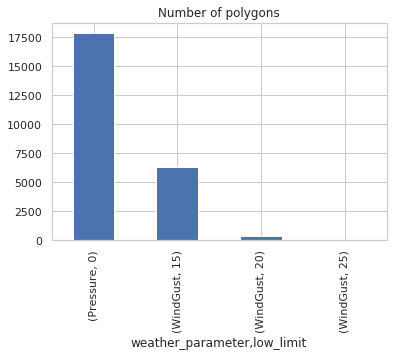

In [11]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id'].plot(kind='bar', title='Number of polygons')

In [29]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id']

weather_parameter  low_limit
Pressure           0            17865
WindGust           15            6333
                   20             336
                   25               8
Name: id, dtype: int64

#### Histogram of outage count

Number of outages caused by the storms.

In [19]:
counts = df.groupby(by=['outages']).count()['id']
print(counts)
print(sum(counts[(counts.index > 10)]))

outages
0      22179
1       1490
2        383
3        166
4         94
5         40
6         44
7         38
8         18
9         14
10        11
11        13
12         7
13         4
14         6
15         2
16         4
17         2
18         1
19         2
20         1
23         2
26         1
27         1
28         1
32         1
33         2
34         1
37         1
39         1
40         1
41         1
42         3
43         1
55         1
58         1
60         1
75         1
83         1
114        1
Name: id, dtype: int64
65


In [127]:
def objects_per_outages(df, by='outages', xlabel='Caused outages', fontsize=15, dpi=600):

    fig, ax = plt.subplots(figsize=(15,6), dpi=600)
    
    plt.rc('font', size=fontsize)
    plt.xticks(fontsize=fontsize*3/4)    
    plt.yticks(fontsize=fontsize*3/4)

    df.groupby(by=[by]).count()['id'].plot(kind='bar', ax=ax, color='xkcd:sky blue')
    plt.yscale('log')
    
    plt.grid(False)    
    plt.gca().yaxis.grid(True)
    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    
    ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
    ax.yaxis.get_major_formatter().set_scientific(False)
    
    #plt.title('Number of storm objects per caused outages', fontsize=fontsize)
    plt.xlabel(xlabel, fontsize=fontsize)        
        
    plt.ylabel('Number of storm objects', fontsize=fontsize)    
    
    plt.xticks(rotation=45)
    max_ticks = 20
    l = len(df.groupby(by=[by]).count()['id'])
    if l > max_ticks:
        every_nth = int(l / max_ticks)
    for n, label in enumerate(ax.xaxis.get_ticklabels()):
        if n % every_nth != 0:
            label.set_visible(False)

Objects per outages

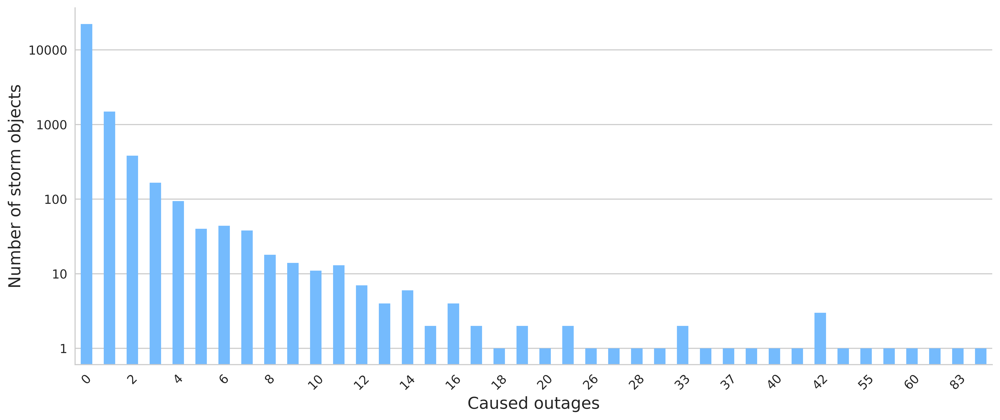

In [128]:
objects_per_outages(df, by='outages', xlabel='Caused outages', dpi=600)

Objects per customer

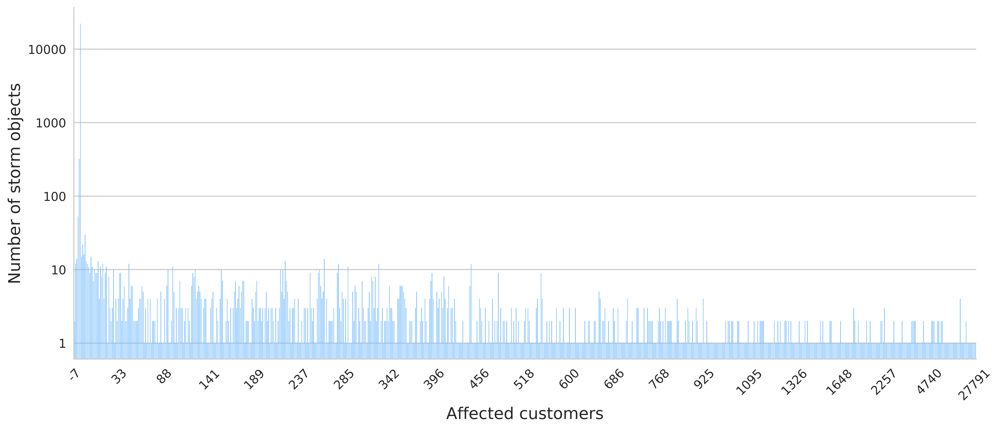

In [129]:
objects_per_outages(df, by='customers', xlabel='Affected customers', dpi=600)

#### Class sizes

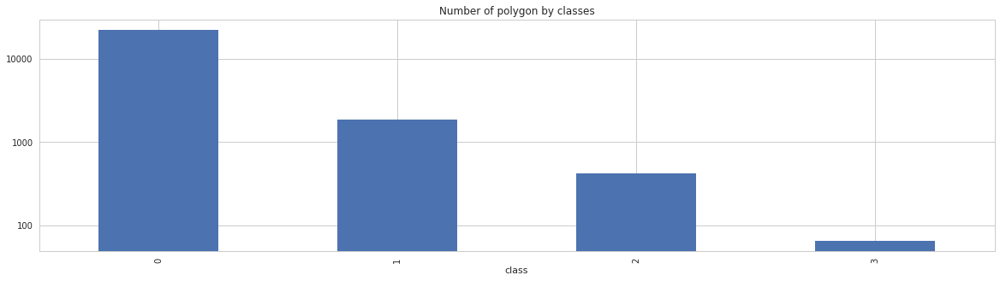

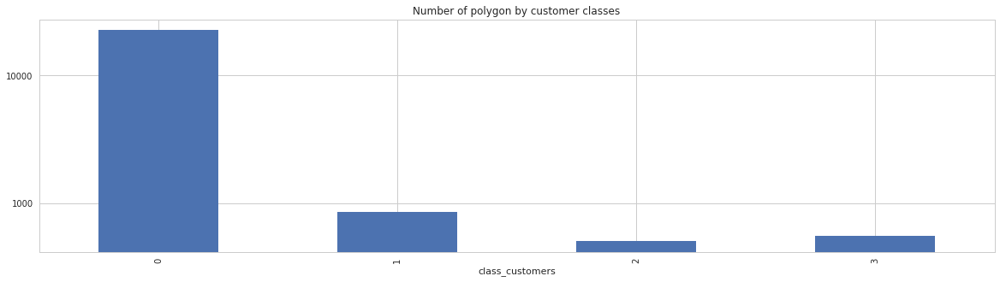

In [32]:
fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class']).count()['id'].plot(kind='bar', title='Number of polygon by classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class_customers']).count()['id'].plot(kind='bar', title='Number of polygon by customer classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

#### Class Distribution

From above plots we can see that most of the polygons cause only 1 outage. It is notable that because reason of outages are not saved reliably, this bin may include a lot of noise. Outages are always reported from transformers. Second and third plot help us to give sense how many customers (namely houses) each outage means. 

First, if number of outages is 0, the class is 0. Rest of the dataset could be divided to classes following: 

Class 1:  1 - 2  outages  --> max ~50 customers without electricity<br>
Class 2:  3 - 10 outages  --> max ~250 customers without electricity <br>
Class 3: 11 -    outages  --> lots of customers without electricity<br>

We can also classify the data based on number of customers respectively:. 

Class 1:   1 - 250 cusomters  --> max ~2 outages<br>
Class 2: 251 - 500 customers  --> max ~10 outages <br>
Class 3: 501 -     customers  --> lots of outages<br>

In [155]:
# Scatter
def scatter_customers_outages(df, fontsize=15, dpi=600):

    fig, ax = plt.subplots(figsize=(15,15), dpi=dpi)
    
    plt.rc('font', size=fontsize)
    plt.xticks(fontsize=fontsize*3/4)    
    plt.yticks(fontsize=fontsize*3/4)

    plt.gca().spines['top'].set_visible(False)
    plt.gca().spines['right'].set_visible(False)
    
    df.plot(kind='scatter', x='outages', y='customers', ax=ax, c='xkcd:sky blue')
    
    plt.xlabel('Number of outages', fontsize=fontsize)
    plt.ylabel('Affected customers', fontsize=fontsize)
    
    # Trendline
    z = np.polyfit(df['outages'], df['customers'], 1)
    p = np.poly1d(z)
    plt.plot(df['outages'], p(df['outages']), color='xkcd:rose', linestyle='dashed', linewidth=.75)
    
scatter_customers_outages(df, dpi=600)

#### Timeseries of storms and outages

Storm objects cause some outages. It can be seen from a timeseries of storm objects and outages as well.

In [73]:
def plot_outages(df, parameter, title, limit, groupper='D', fontsize=15, dpi=600):

    fig, ax = plt.subplots(figsize=(15,6), dpi=dpi)
    plt.rc('font', size=fontsize)

    plt.xticks(fontsize=fontsize*3/4)    
    plt.yticks(fontsize=fontsize*3/4)
    
    plt.gca().spines['top'].set_visible(False)
    
    ax2 = ax.twinx()
    
    #df[(df.loc[:,'weather_parameter'] == parameter) & (df.loc[:,'low_limit'] == limit)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq=groupper)]).count().plot.line(ax=ax, alpha=.8, color='xkcd:sky blue', label='Storm objects')
    s = df[(df.loc[:,'weather_parameter'] == parameter) & (df.loc[:,'low_limit'] == limit)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq=groupper)]).count()
    ax.bar(s.index, s, alpha=.8, width=.02, color='xkcd:sky blue', label='Storm objects')
    s2 = df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq=groupper)]).sum()
    ax2.plot(s2.index, s2, color='xkcd:rose', linestyle='dashed', label='Outages')
    #df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq=groupper)]).sum().plot(ax=ax2, color='xkcd:rose', linestyle='dashed', label='Outages')

    fig.autofmt_xdate()

    ax.set_ylabel('Number of storm objects', fontsize=fontsize)
    ax2.set_ylabel('Number of outages', fontsize=fontsize)

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax2.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2, loc='upper left', fontsize=fontsize)            
    
    ax.set_ylim(0, ax.get_ylim()[1])
    ax2.set_ylim(0, ax2.get_ylim()[1])
    
    plt.grid(False)
    plt.title('{} limit {}'.format(title, limit), fontsize=fontsize)
    ax.set_xlabel('Time', fontsize=fontsize)    

    # For second y axis
    plt.yticks(fontsize=fontsize*3/4)    

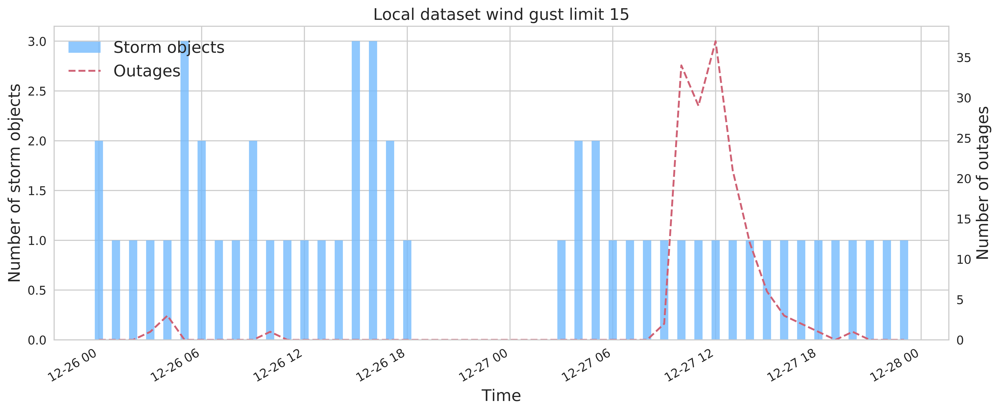

In [74]:
plot_outages(df['2011-12-26':'2011-12-27'], 'WindGust', 'Local dataset wind gust', 15, groupper='H')

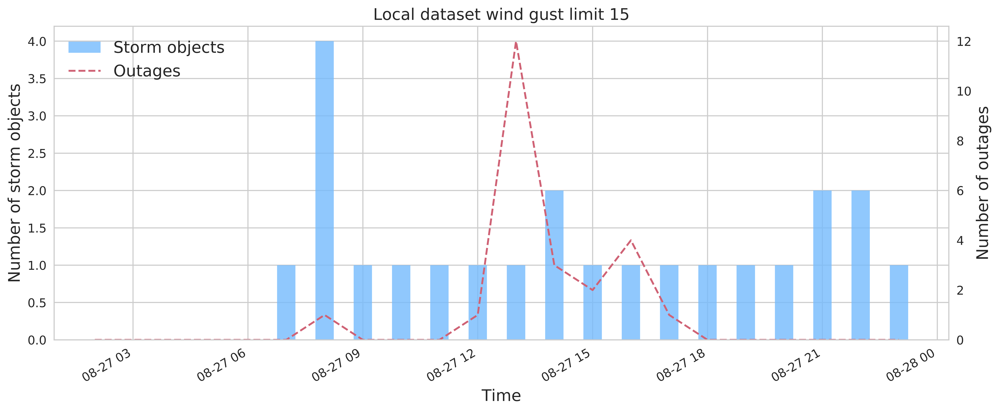

In [75]:
plot_outages(df['2016-08-27':'2016-08-27'], 'WindGust', 'Local dataset wind gust', 15, groupper='H')

In [ ]:
plot_outages(df, 'WindGust', 'Local dataset wind gust', 15)
plot_outages(df, 'WindGust', 'Local dataset wind gust', 20)
plot_outages(df, 'WindGust', 'Local dataset wind gust', 25)

#### Correlation between storms and outages

Correlation between storm objects and number of outages. Strong correlation exists.

In [34]:
def plot_pval(corr_df, ax):

    coeffmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))
    pvalmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))

    for i in range(corr_df.shape[1]):
        for j in range(corr_df.shape[1]):        
            corrtest = pearsonr(corr_df[corr_df.columns[i]], corr_df[corr_df.columns[j]])  

            coeffmat[i,j] = corrtest[0]
            pvalmat[i,j] = corrtest[1]

    pvalmat_df = pd.DataFrame(pvalmat, columns=corr_df.columns, index=corr_df.columns)
    #fig, ax = plt.subplots(figsize=(6,6))
    sns.heatmap(pvalmat_df, cmap="YlGnBu", annot=True, ax=ax)
    
def plot_corr(df):
    s = df[(df.loc[:,'weather_parameter'] == 'Pressure')].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s2 = df[(df.loc[:,'weather_parameter'] == 'WindGust') & (df.loc[:,'low_limit'] == 15)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s3 = df[(df.loc[:,'weather_parameter'] == 'WindGust') & (df.loc[:,'low_limit'] == 20)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s4 = df[(df.loc[:,'weather_parameter'] == 'WindGust') & (df.loc[:,'low_limit'] == 25)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count()
    s5 = df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq='D')]).sum()
    corr_df = pd.concat([s, s2, s3, s4, s5], axis=1, 
                        keys = ['Pressure', 'Wind Gust 15 m/s', 'Wind Gust 20 m/s', 'Wind Gust 25 m/s', 'Nro Outages'])
    corr_df.fillna(0, inplace=True)
    corr = corr_df.corr('pearson')

    fig, axes = plt.subplots(1, 2, figsize=(12,6))
    sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0])
    axes[0].set_title('Correlation matrix')
    
    plot_pval(corr_df, ax=axes[1])
    axes[1].set_title('P-value test')
    plt.tight_layout()

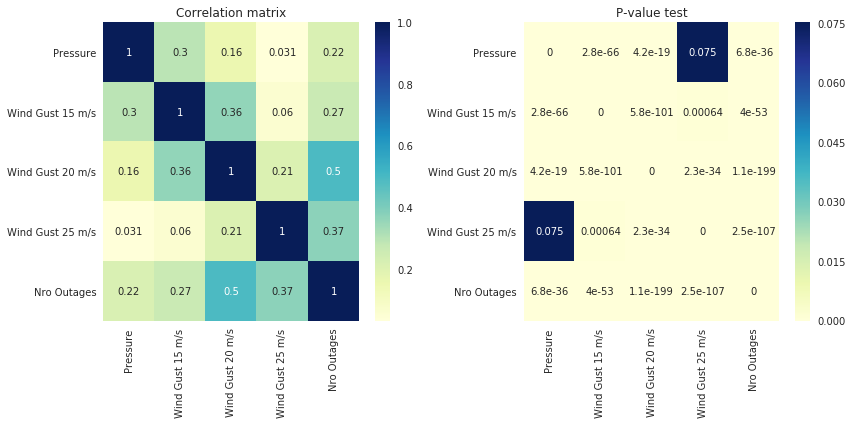

In [35]:
plot_corr(df)

#### Correlation between weather parameters and outages

Correlation between outages and different weather parameters (see two last rows). Significant correlation exists with at least: speed, area, temperature, standard deviation of the wind speed, total column water vapor, mixed layer height, CAPE, Dewpoint, total cloud cover, wind gust and pressure.

At least CAPE is most probably related to convective weather. 

P-value test passes for all parameters.

In [70]:
def plot_pval_(corr_df, ax):

    coeffmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))
    pvalmat = np.zeros((corr_df.shape[1], corr_df.shape[1]))

    for i in range(corr_df.shape[1]):
        for j in range(corr_df.shape[1]):        
            corrtest = pearsonr(corr_df[corr_df.columns[i]], corr_df[corr_df.columns[j]])  

            coeffmat[i,j] = corrtest[0]
            pvalmat[i,j] = corrtest[1]

    pvalmat_df = pd.DataFrame(pvalmat, columns=corr_df.columns, index=corr_df.columns)
    g = sns.heatmap(pvalmat_df, cmap="YlGnBu", annot=True, ax=ax, annot_kws={"size": 20}, cbar=False)
    g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
    g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
    
df2 = df.loc[:, storm_params + outage_params].fillna(0)
corr = df2.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(80,160))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df2, ax=axes[1])
axes[1].set_title('P-value test')
plt.tight_layout()

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


Let's consider only winter months (from beginning of October to end of January). Now we don't have significant correlation between CAPE and outages but we do have much stronger correlation between most other parameters. Distance to pressure object and wind speed introduce also a significant correlation with outages.

P-value test do not pass for several parameter any more, however. We have much less data (826 rows).

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


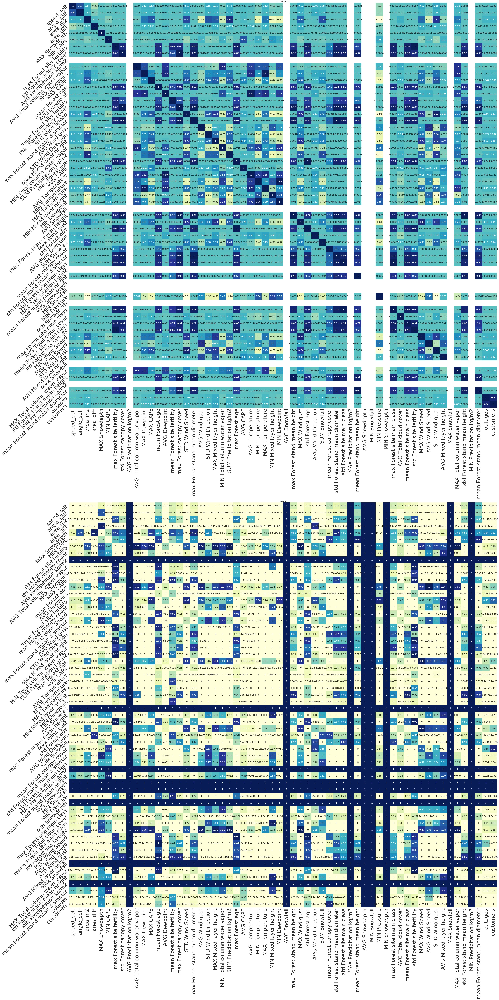

In [71]:
df3 = df.loc[(df.index.month >= 10) | (df.index.month <= 1), storm_params + outage_params].fillna(0)
corr = df3.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df3, ax=axes[1])
axes[1].set_title('P-value test')
plt.tight_layout()

#### Scatter plots of outages and weather parameters

Scatter plot for outages with each parameters:

In [43]:
def scatter_outages(df):
    rowcount = (int)(len(storm_params)/3)+1
    fig, axes = plt.subplots(rowcount, 3, figsize=(30,90))
    row, col, i = 0, 0, 0
    for p in storm_params:
        row = int(i/3)
        col = i%3
        tdf = df.loc[(df[p] != -999), ['outages', p]].astype(float)
        tdf.plot(kind='scatter', x='outages', y=p, c='g', ax=axes[row][col])
        i += 1

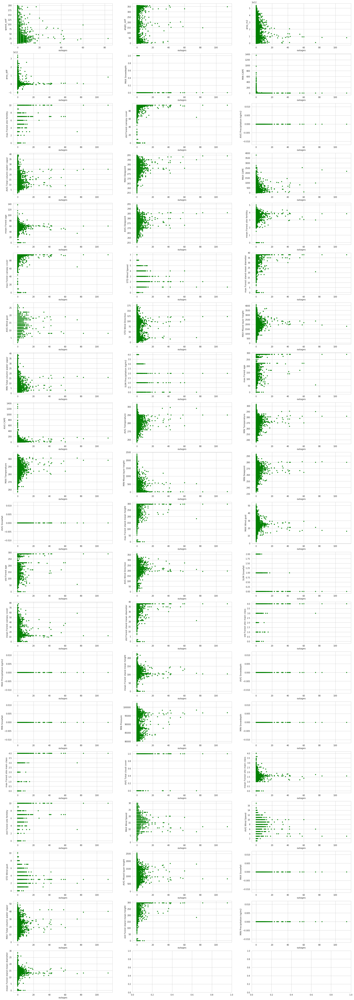

In [45]:
scatter_outages(df)

And the same for the winter months:

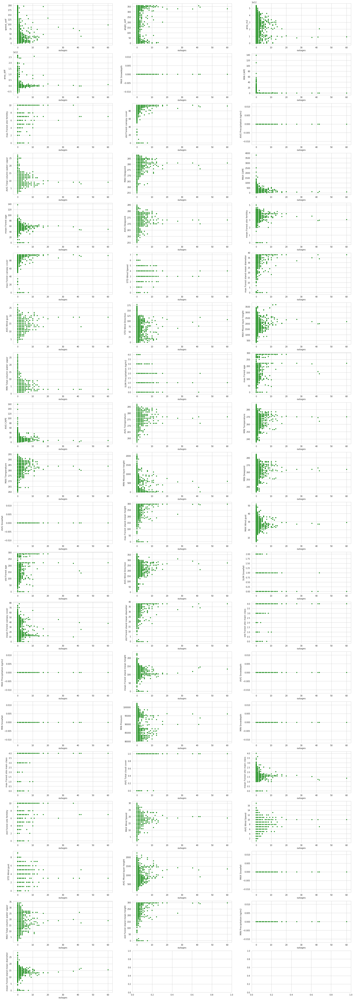

In [46]:
scatter_outages(df3)

#### Fit gaussian to parameters

Next, we fit gaussian distribution to each parameter and plot it along histogram. We also plot classes 1 and 2 values in pre-defined testset. 

In [71]:
from scipy.stats import norm
from math import ceil

def fit_gaussians(df, df_1, df_2, labels, columns, fontsize=15, dpi=70):
        
    rowcount = ceil(len(columns)/3)
    fig, axes = plt.subplots(rowcount, 3, figsize=(24,26), dpi=dpi)
    
    plt.rc('font', size=fontsize)

    axes=[]
    for i, p in enumerate(columns):            
        row = int(i/3)
        col = i%3
        
        axes.append(plt.subplot(rowcount, 3, i+1))
        
        fit_gaussian([df[p], df_1[p], df_2[p]], p, labels, fontsize=fontsize)
    
    plt.tight_layout()
    axes[1].legend(fontsize=fontsize, bbox_to_anchor=(.5, 1.62), ncol=4, loc='upper center', frameon=False)

def fit_gaussian(datasets, param, labels, fontsize=15):
    """ 
    Fit gaussian to data 
    
    data : Series | list
           data to be fitted
    """
    
    plt.hist(datasets[0], bins=50, density=True, color='xkcd:tea', alpha=.6, label='Histogram of all samples')
    colors = ['xkcd:bluish purple', 'xkcd:coral', 'xkcd:taupe', 'xkcd:dark brown']
    linestyles = ['solid', 'dashed', 'dashdot']
    
    plt.xticks(fontsize=fontsize) #*3/4)    
    plt.yticks(fontsize=fontsize) #*3/4)
    
    for i,data in enumerate(datasets):
        mean, std = norm.fit(data)

        xmin, xmax = plt.xlim()
        x = np.linspace(xmin, xmax, 100)
        y = norm.pdf(x, mean, std)
    
        # Mean 
        plt.axvline(mean, color=colors[i], linestyle='dashed', linewidth=1)
        min_ylim, max_ylim = plt.ylim()
        if np.isfinite(mean):
            plt.text(mean, max_ylim*0.9**(2*i), 'Mean: {:.2f}'.format(mean), color=colors[i])

        if mean >= 10000:
            plt.gca().ticklabel_format(style='sci',scilimits=(-3,4), axis='x')

        plt.grid(False)
        plt.gca().spines['top'].set_visible(False)
        plt.gca().spines['right'].set_visible(False)

        plt.plot(x, y, color=colors[i], linestyle=linestyles[i], label=labels[i])
        
    col_names = {'speed_self': 'Object movement speed',
                 'angle_self': 'Object movement angle',
                 'area_m2': 'Object size',
                 'area_diff': 'Object area difference to the previous time step',
                 'mean Forest stand mean height': 'AVG Forest stand height'
                }
    if param in col_names.keys():
        param = col_names[param]
        
    plt.title(param, y=1.08, fontsize=fontsize)

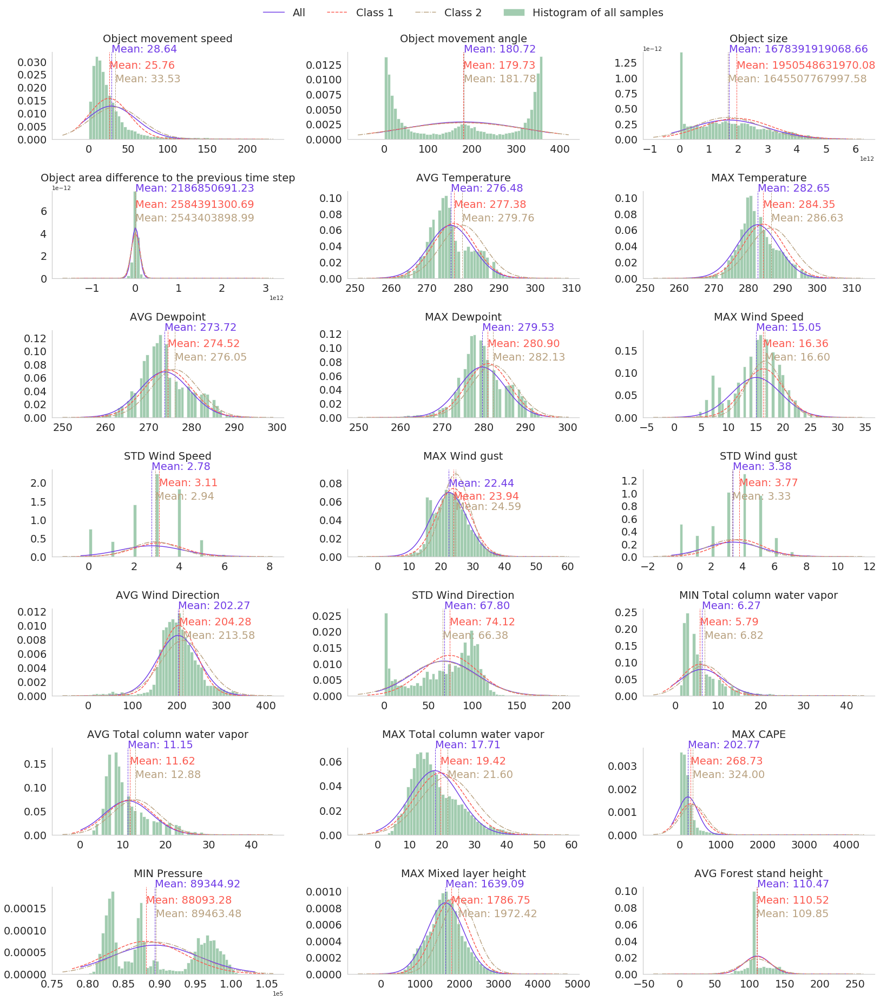

In [72]:
df['week'] = df.index.week
exclude = [
    'MIN Precipitation kg/m2', 'AVG Precipitation kg/m2', 'MAX Precipitation kg/m2', 'SUM Precipitation kg/m2',
    'MIN Snowfall','AVG Snowfall','MAX Snowfall','SUM Snowfall',
    'MIN Snowdepth','AVG Snowdepth','MAX Snowdepth',
    'std Forest age', 'std Forest site fertility', 'std Forest stand mean diameter', 'std Forest stand mean height',
    'std Forest canopy cover', 'std Forest site main class', 'low_limit', 'AVG Total cloud cover', 'MIN CAPE', 'AVG CAPE',
    'mean Forest site fertility', 'max Forest site fertility', 'mean Forest stand mean diameter', 'max Forest stand mean diameter',
    'mean Forest age', 'max Forest age', 'mean Forest site main class', 'max Forest site main class', 'mean Forest canopy cover',
    'max Forest canopy cover', 'week', 'max Forest stand mean height', 'MIN Temperature', 'MIN Dewpoint', 'AVG Wind Speed', 'AVG Wind gust',
    'MIN Total column vapor', 'AVG Total column vapor', 'MIN Mixed layer height', 'AVG Mixed layer height'
]
# This messes the order in options.feature_params
#cols_to_plot = list(set(options.feature_params) - set(exclude))
cols_to_plot = []
for p in options.feature_params:
    if p not in exclude:
        cols_to_plot.append(p)

df.replace(-999., np.NaN, inplace=True)
df.dropna(inplace=True)

fit_gaussians(df[cols_to_plot], df[cols_to_plot][(df['class']==1)], df[cols_to_plot][(df['class']==2)], ['All', 'Class 1', 'Class 2'], columns=cols_to_plot, fontsize=20)

### Energiateollisuus

#### Load dataset

Load ready dataset from database:

In [66]:
ene_dataset = load_dataset(table_name='classification_dataset_energiateollisuus_forest')

In [67]:
df_ene = ene_dataset.copy()

#### Number of different types of polygons

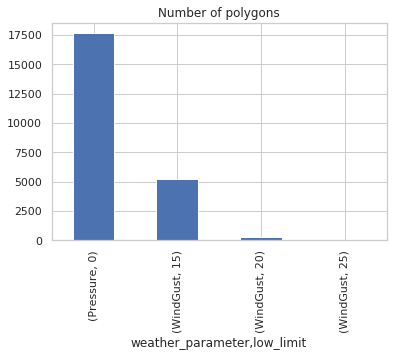

In [68]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id'].plot(kind='bar', title='Number of polygons')

In [51]:
df.groupby(by=['weather_parameter', 'low_limit']).count()['id']

weather_parameter  low_limit
Pressure           0            29690
WindGust           15           93717
                   20           17240
                   25            1988
                   30             238
Name: id, dtype: int64

#### Histogram of outage count

Number of outages caused by the storms.

In [23]:
print(df.groupby(by=['outages']).count()['id'].head())
print('[...]')
print(df.groupby(by=['outages']).count()['id'].tail())

counts = df.groupby(by=['outages']).count()['id']
print(sum(counts[(counts.index > 10)]))
print(sum(counts))

outages
0    109074
1      6589
2      3232
3      1968
4      1275
Name: id, dtype: int64
[...]
outages
14873    2
14936    1
15248    3
15940    1
15989    2
Name: id, dtype: int64
17587
142873


Objects per outages

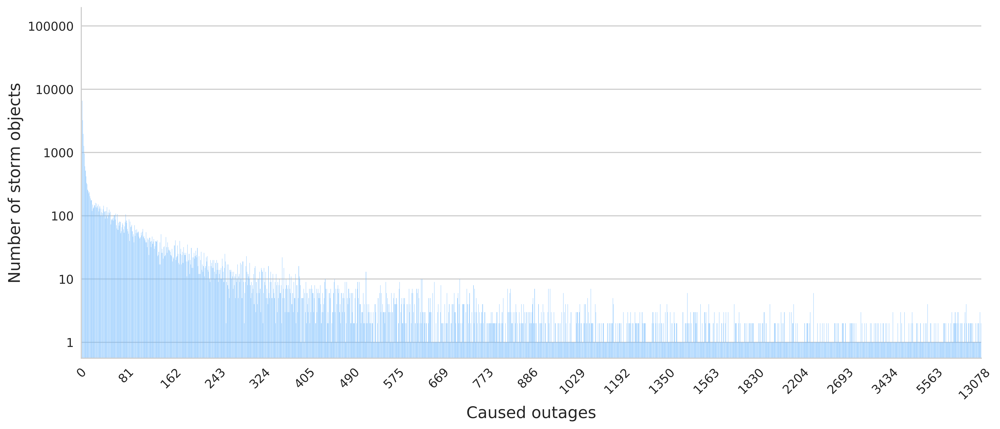

In [132]:
objects_per_outages(df_ene, by='outages', xlabel='Caused outages', dpi=600)

Objects per customer

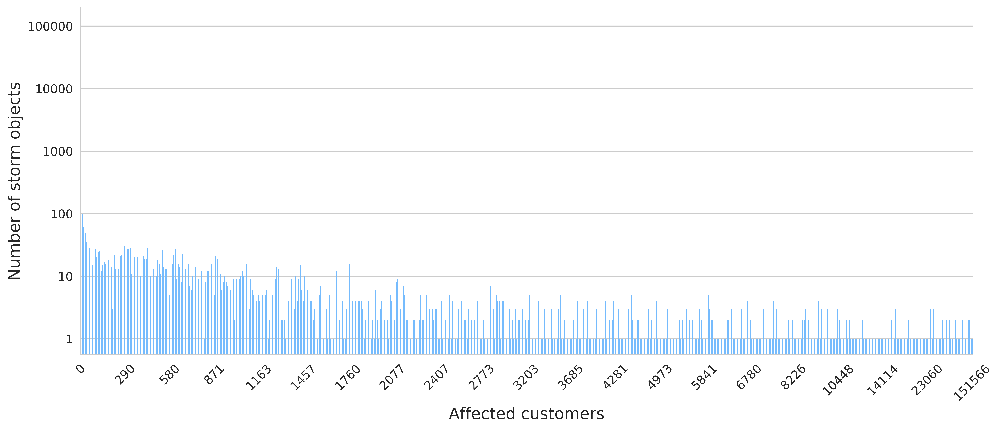

In [133]:
objects_per_outages(df_ene, by='customers', xlabel='Affected customers', dpi=600)

#### Class sizes

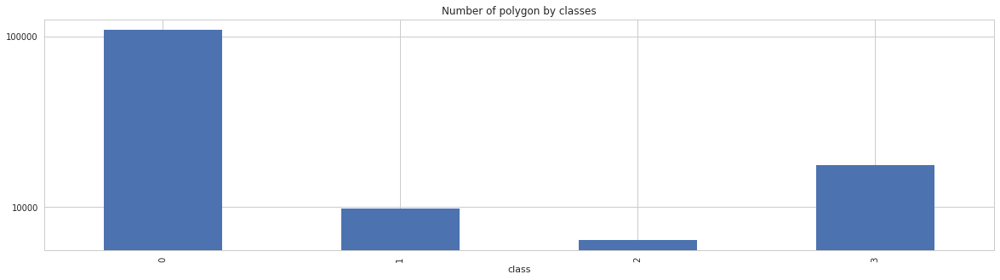

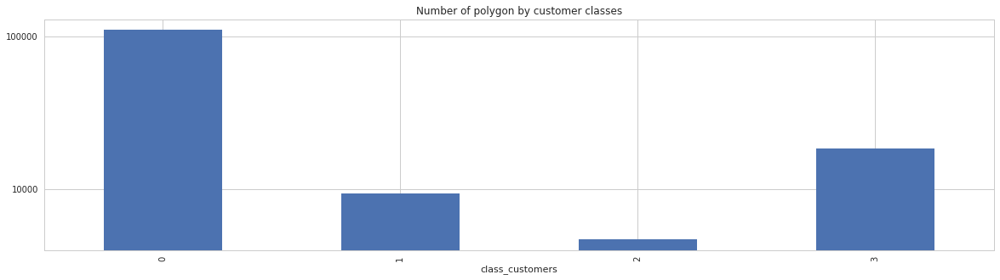

In [54]:
fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class']).count()['id'].plot(kind='bar', title='Number of polygon by classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

fig, ax = plt.subplots(figsize=(20,5))
df.groupby(by=['class_customers']).count()['id'].plot(kind='bar', title='Number of polygon by customer classes', ax=ax)
plt.yscale('log')
ax.yaxis.set_major_formatter(mticker.ScalarFormatter())
ax.yaxis.get_major_formatter().set_scientific(False)

Following plots help us to divide data to classes.

In [159]:
# Scatter
scatter_customers_outages(df_ene, dpi=600)

We can also scatter number of polygons against customers and outages.

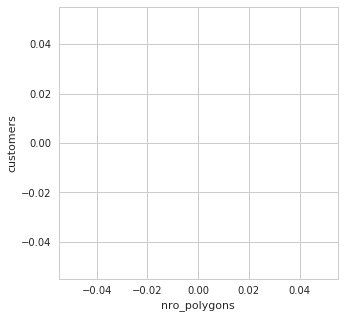

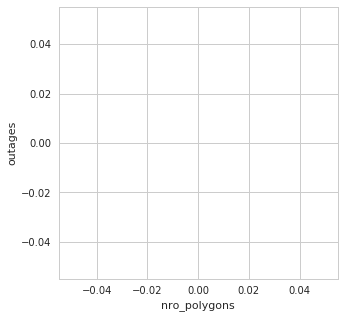

In [56]:
# Scatter
fig, ax = plt.subplots(figsize=(5,5))
df = pd.DataFrame(ene_dataset)
df['nro_polygons'] = df.loc[(df['outages'] >= 1), :].groupby(by=['outages']).count()['id']
df.plot(kind='scatter', x='nro_polygons', y='customers', ax=ax, c='green')
fig, ax = plt.subplots(figsize=(5,5))
df.plot(kind='scatter', x='nro_polygons', y='outages', ax=ax, c='green')

First, if number of outages is 0, the class is 0. Rest of the dataset could be divided to classes following (based on the first ploit): 

Class 1:   1 - 250  outages<br>
Class 2: 251 - 750  outages<br>
Class 3: 751 -      outages<br>

We can also classify the data based on number of customers respectively (based on the second plot): 

Class 1:    1 - 1000 customers<br>
Class 2: 1001 - 3000 customers<br>
Class 3: 3001 -      customers <br>

#### Timeseries of storms and outages

Storm objects cause some outages. It can be seen from a timeseries of storm objects and outages as well.

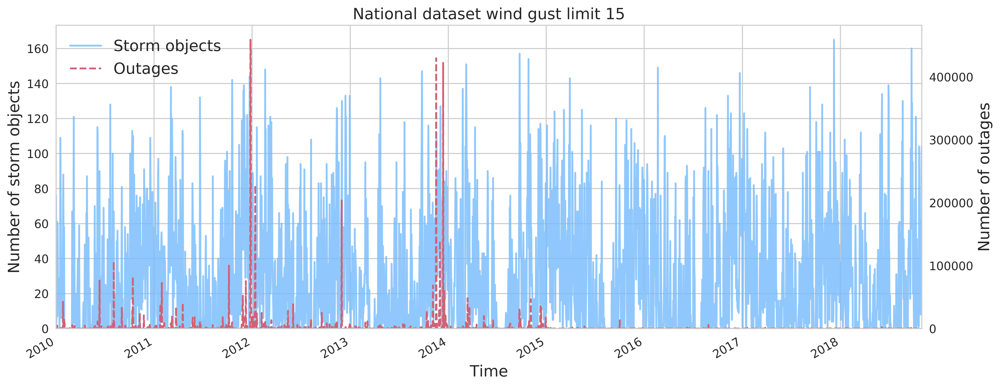

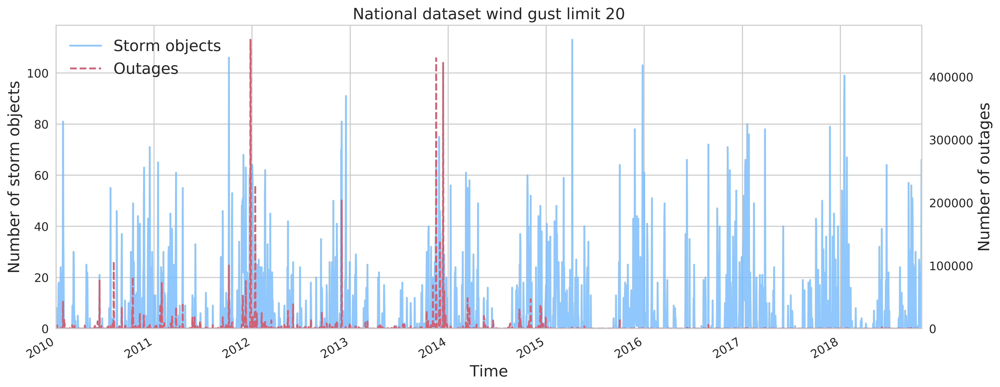

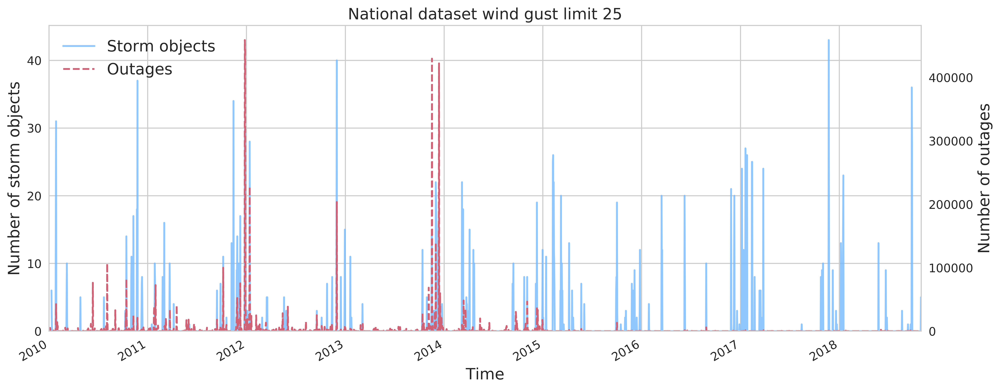

In [33]:
plot_outages(df_ene, 'WindGust', 'National dataset wind gust', 15)
plot_outages(df_ene, 'WindGust', 'National dataset wind gust', 20)
plot_outages(df_ene, 'WindGust', 'National dataset wind gust', 25)

In [32]:
def plot_outages_customers(df, title, fontsize=15, dpi=600):

    fig, ax = plt.subplots(figsize=(15,6), dpi=dpi)
    plt.rc('font', size=fontsize)

    plt.xticks(fontsize=fontsize*3/4)    
    plt.yticks(fontsize=fontsize*3/4)
    
    plt.gca().spines['top'].set_visible(False)
    
    ax2 = ax.twinx()
    
    #df[(df.loc[:,'weather_parameter'] == parameter) & (df.loc[:,'low_limit'] == limit)].loc[:,'weather_parameter'].groupby(by=[pd.Grouper(freq='D')]).count().plot(ax=ax, alpha=.8, color='xkcd:sky blue', label='Storm objects')
    df.loc[:, 'customers'].groupby(by=[pd.Grouper(freq='D')]).sum().plot(ax=ax, color='xkcd:tea', linestyle='dotted', label='Customers')
    df.loc[:, 'outages'].groupby(by=[pd.Grouper(freq='D')]).sum().plot(ax=ax2, color='xkcd:rose', linestyle='dashed', label='Outages', linewidth=.5)
    fig.autofmt_xdate()

    ax.set_ylabel('Affected customers', fontsize=fontsize)
    ax2.set_ylabel('Number of outages', fontsize=fontsize)

    h1, l1 = ax.get_legend_handles_labels()
    h2, l2 = ax2.get_legend_handles_labels()
    ax.legend(h1+h2, l1+l2, loc='upper left', fontsize=fontsize)            
    
    ax.set_ylim(0, ax.get_ylim()[1])
    ax2.set_ylim(0, ax2.get_ylim()[1])
    
    plt.grid(False)
    #plt.title('{} limit {}'.format(title, limit), fontsize=fontsize)
    plt.title('{}'.format(title), fontsize=fontsize)
    ax.set_xlabel('Time', fontsize=fontsize)    

    # For second y axis
    plt.yticks(fontsize=fontsize*3/4)

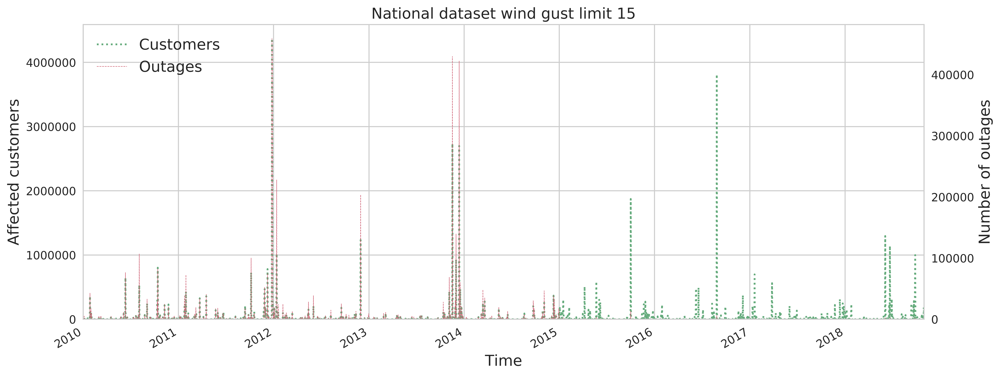

In [31]:
plot_outages_customers(df_ene, 'WindGust', 'National dataset wind gust', 15)

#### Correlation between storms and outages

Correlation between storm objects and number of outages. Strong correlation exists.

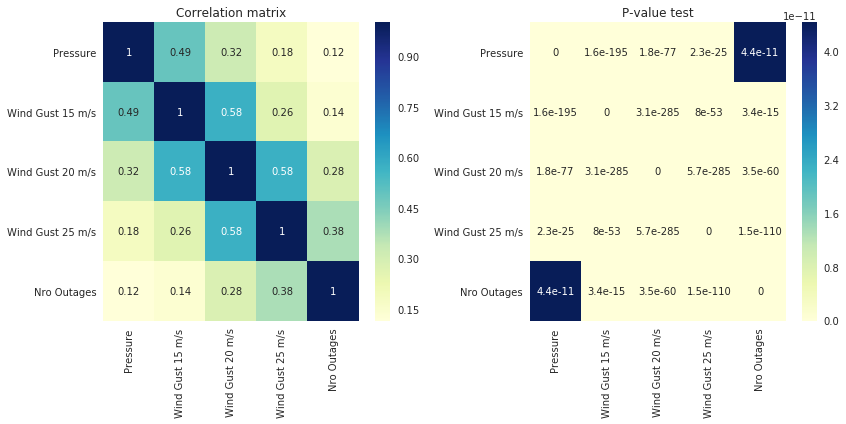

In [58]:
plot_corr(df) # Function defined in Loiste & JSE analysis

#### Correlation between weather parameters and outages

Correlation between outages and different weather parameters (see two last rows). Significant correlation exists with at least: area_m2, Max wind speed, STD Wind Speed, Max Wind Gust, STD Wind Gust, Max Precipitation kg/m2, SUM Precipitation KG/m2, Sum Snowfall, AVG Mixed layer height, Max Mixed layer height.

P-value test passes for all parameters having significant correlation except for Max precipitation kg/m2 (why?).

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


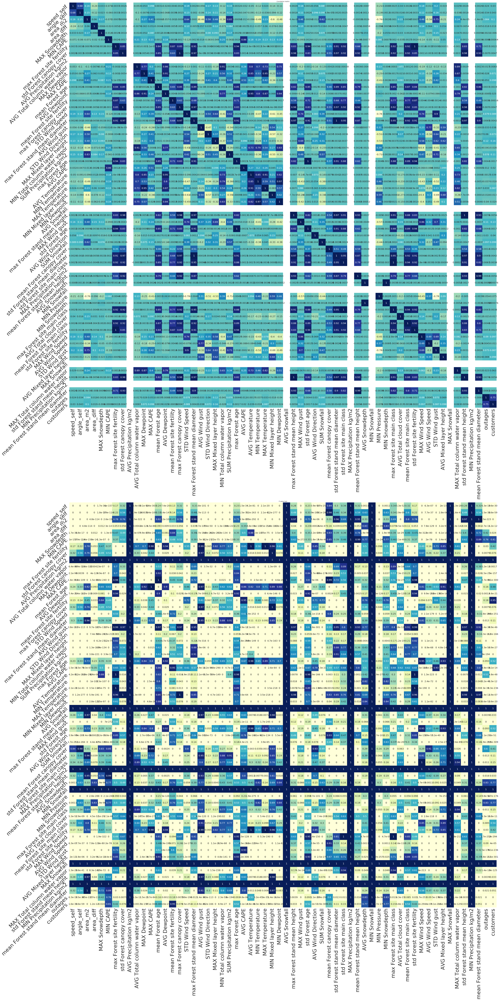

In [72]:
df2 = df.loc[:, storm_params + outage_params].fillna(0)
corr = df2.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df2, ax=axes[1]) # Function defined in Loiste & JSE Analysis
axes[1].set_title('P-value test')
plt.tight_layout()

Let's consider only winter months (from beginning of October to end of January). Correlations are same with whole dataset.

P-value test passes for all paratemers having significant correlation  except AVG windspeed (why?).

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/scipy/stats/stats.py:3010: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


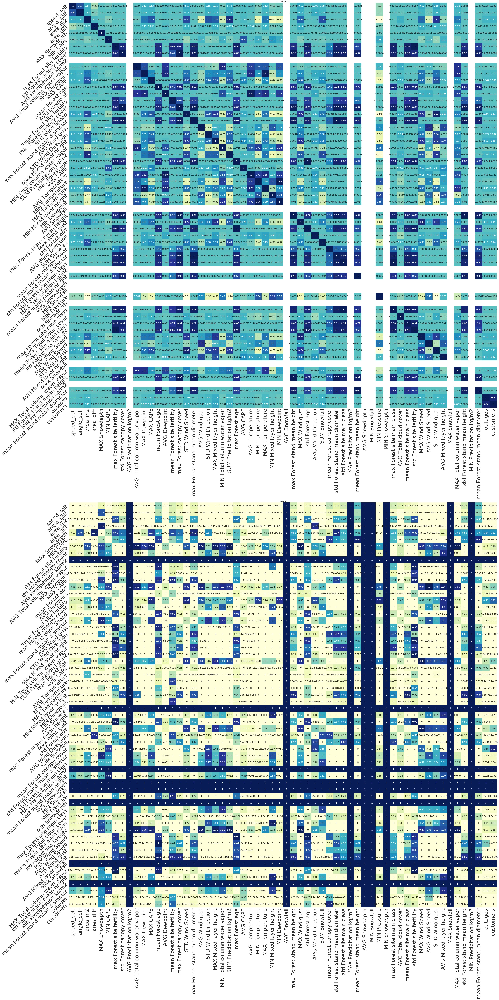

In [73]:
df3 = df.loc[(df.index.month >= 10) | (df.index.month <= 1), storm_params + outage_params].fillna(0)
corr = df3.corr('pearson')

#fig, axes = plt.subplots(1, 2, figsize=(45,30))
fig, axes = plt.subplots(2, 1, figsize=(60,120))
g = sns.heatmap(corr, cmap="YlGnBu", annot=True, ax=axes[0], annot_kws={"size": 20}, cbar=False)
g.set_xticklabels(g.get_xmajorticklabels(), fontsize=45)
g.set_yticklabels(g.get_ymajorticklabels(), fontsize=45, rotation=45)
axes[0].set_title('Correlation matrix')

plot_pval_(df3, ax=axes[1])
axes[1].set_title('P-value test')
plt.tight_layout()

#### Scatter plots of outages and weather parameters

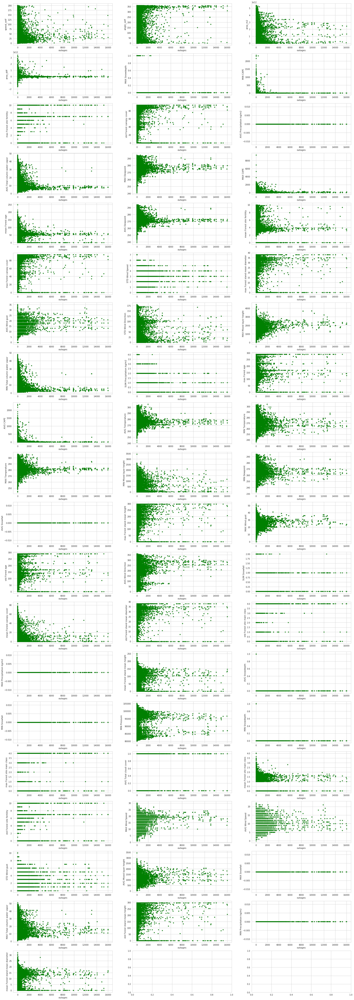

In [61]:
scatter_outages(df) # Function defined in Loiste & JSE analysis

And the same for the winter months:

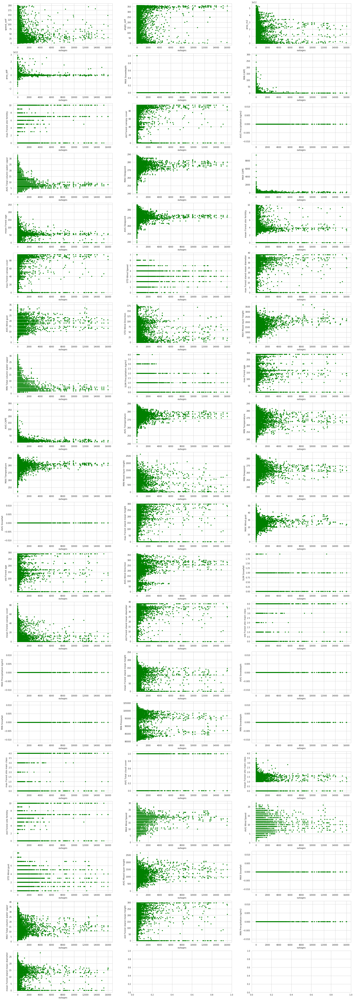

In [62]:
scatter_outages(df3)

#### Fit gaussian to parameters

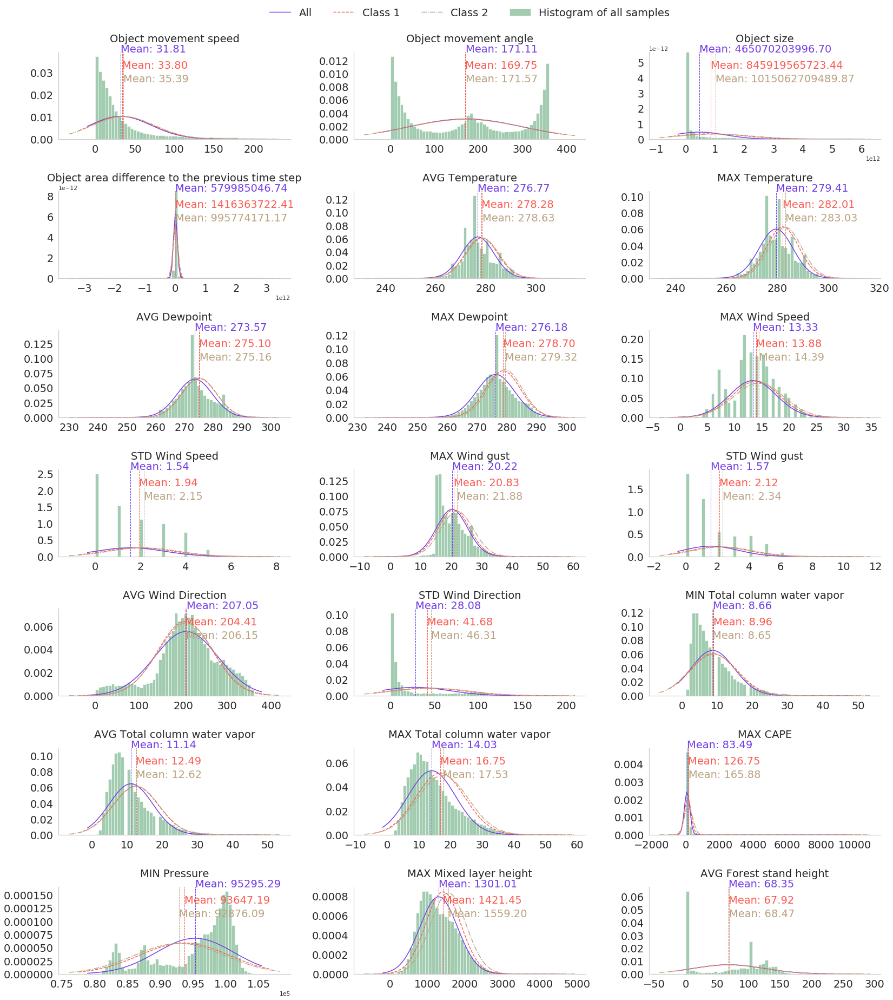

In [73]:
df_ene['week'] = df_ene.index.week
exclude = [
    'MIN Precipitation kg/m2', 'AVG Precipitation kg/m2', 'MAX Precipitation kg/m2', 'SUM Precipitation kg/m2',
    'MIN Snowfall','AVG Snowfall','MAX Snowfall','SUM Snowfall',
    'MIN Snowdepth','AVG Snowdepth','MAX Snowdepth',
    'std Forest age', 'std Forest site fertility', 'std Forest stand mean diameter', 'std Forest stand mean height',
    'std Forest canopy cover', 'std Forest site main class', 'low_limit', 'AVG Total cloud cover', 'MIN CAPE', 'AVG CAPE',
    'mean Forest site fertility', 'max Forest site fertility', 'mean Forest stand mean diameter', 'max Forest stand mean diameter',
    'mean Forest age', 'max Forest age', 'mean Forest site main class', 'max Forest site main class', 'mean Forest canopy cover',
    'max Forest canopy cover', 'week', 'max Forest stand mean height', 'MIN Temperature', 'MIN Dewpoint', 'AVG Wind Speed', 'AVG Wind gust',
    'MIN Total column vapor', 'AVG Total column vapor', 'MIN Mixed layer height', 'AVG Mixed layer height'
]
# This messes the order in options.feature_params
#cols_to_plot = list(set(options.feature_params) - set(exclude))
cols_to_plot = []
for p in options.feature_params:
    if p not in exclude:
        cols_to_plot.append(p)

df_ene.replace(-999., np.NaN, inplace=True)
df_ene.dropna(inplace=True)

fit_gaussians(df_ene[cols_to_plot], df_ene[cols_to_plot][(df_ene['class']==1)], df_ene[cols_to_plot][(df_ene['class']==2)], ['All', 'Class 1', 'Class 2'], columns=cols_to_plot, fontsize=20)

#### Precision matrix

In [63]:
cov_data = df.loc[:, storm_params].dropna()

In [ ]:
gl = GraphicalLassoCV(cv=3, mode='cd')
gl.fit(cov_data.astype(np.float))

In [ ]:
cov_ = cov_data.cov()
prec_ = linalg.inv(cov_)

In [66]:
lw_cov_, _ = ledoit_wolf(cov_data.astype(np.float))
lw_prec_ = linalg.inv(lw_cov_)

In [67]:
def vis_covs(covs, param_list, title='covariance'):
    # plot the precisions
    plt.figure(figsize=(10, 10*len(covs)))
    for i, (name, this_prec) in enumerate(covs):
        params = param_list[i]
        ticks = np.arange(0.5, len(params)+.5, 1)
        y_ticks = list(ticks)
        y_ticks.reverse()
        minor_ticks = np.arange(0, len(params), 1)
        
        vmax = .9 * this_prec.max()
        ax2 = plt.subplot(len(precs), 1, i + 1)
        im = plt.imshow(this_prec, 
                        extent=(0, len(params), 0, len(params)),
                        vmin=-vmax, vmax=vmax,
                        cmap="bwr", 
                        aspect='equal')

        plt.xticks(ticks=ticks, labels=params, rotation=90)
        plt.yticks(ticks=y_ticks, labels=params)
        ax2.set_xticks(minor_ticks, minor=True)
        ax2.set_yticks(minor_ticks, minor=True)

        plt.title('{} {}'.format(name, title))
        ax2.set_facecolor('.7')
        ax2.grid(which='minor', color='black', linestyle='--', linewidth=.2)        
        ax2.grid(False, which='major')

        divider = make_axes_locatable(ax2)
        cax2 = divider.append_axes("right", size="5%", pad=0.05)
        plt.colorbar(ax=ax2, cax=cax2)

    plt.tight_layout()
    plt.show()

In [ ]:
covs = [('Ledoit-Wolf', lw_cov_),
        #('GraphicalLassoCV', gl.covariance_),
        #('True', cov_.values)
        ]
precs = [('Ledoit-Wolf', lw_prec_),
         #('GraphicalLasso', gl.precision_), 
         #('True', prec_)
        ]
params = [storm_params, cov_.columns]
#vis_cov_prec(covs, precs, params)
vis_covs(covs, params)
vis_covs(precs, params, 'precision')